<a href="https://colab.research.google.com/github/Mosizamani/AAI-521/blob/main/AAI_521_Assignment4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Assignment 4.1

Mostafa Zamaniturk

**Part 1- Feature extraction**

In [ ]:
#Start with uploading the required images on Google drive
import cv2
import matplotlib.pyplot as plt
import numpy as np
import imutils
from google.colab.patches import cv2_imshow
from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!ls

apple.jpg	      haarcascade_frontalface_default.xml
Assignment4.pdf       MostafaZamaniturk_AAI-521-Assignment4.ipynb
Assignment4_pic1.jpg  weld1.jpg
Assignment4_pic2.jpg  weld2.jpg
haarcascade_eye.xml


In [ ]:
%cd /content/drive/MyDrive/ColabNotebooks/AAI-521/Assignment4

/content/drive/MyDrive/ColabNotebooks/AAI-521/Assignment4


In [ ]:
!ls

apple.jpg	      haarcascade_frontalface_default.xml
Assignment4.pdf       MostafaZamaniturk_AAI-521-Assignment4.ipynb
Assignment4_pic1.jpg  weld1.jpg
Assignment4_pic2.jpg  weld2.jpg
haarcascade_eye.xml


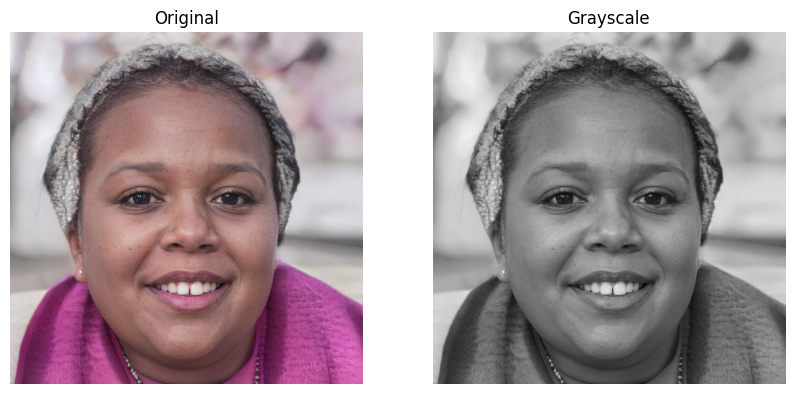

In [ ]:
# Read the original image pic1 and create a regular plus a gray version of it.

# Read original image
img = cv2.imread('/content/drive/MyDrive/ColabNotebooks/AAI-521/Assignment4/Assignment4_pic1.jpg')          # or .png
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # convert BGR → RGB for display

weld1 = cv2.imread('/content/drive/MyDrive/ColabNotebooks/AAI-521/Assignment4/weld1.jpg')          # or .png
weld1 = cv2.cvtColor(weld1, cv2.COLOR_BGR2RGB)  # convert BGR → RGB for display

weld2 = cv2.imread('/content/drive/MyDrive/ColabNotebooks/AAI-521/Assignment4/weld2.jpg')          # or .png
weld2 = cv2.cvtColor(weld2, cv2.COLOR_BGR2RGB)  # convert BGR → RGB for display

# Create grayscale
gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
weld1_gray = cv2.cvtColor(weld1, cv2.COLOR_RGB2GRAY)
weld2_gray = cv2.cvtColor(weld2, cv2.COLOR_RGB2GRAY)

# The result should be similar to what you see in instrcutions

# Plot
f = plt.figure(figsize=(10, 5))
f.add_subplot(1, 2, 1)
plt.imshow(img)
plt.title("Original")
plt.axis("off")

f.add_subplot(1, 2, 2)
plt.imshow(gray, cmap='gray')
plt.title("Grayscale")
plt.axis("off")

plt.show()

1. Initialize the SIFT detector.
2. Detect keypoints and compute descriptors from the grayscale image.
3. Create copies of the original image for drawing results.
4. Draw rich keypoints that include size and orientation.
5. Draw simple keypoints that show only the keypoint locations.
6. Display both results side-by-side using Matplotlib.

Number of keypoints detected: 1857


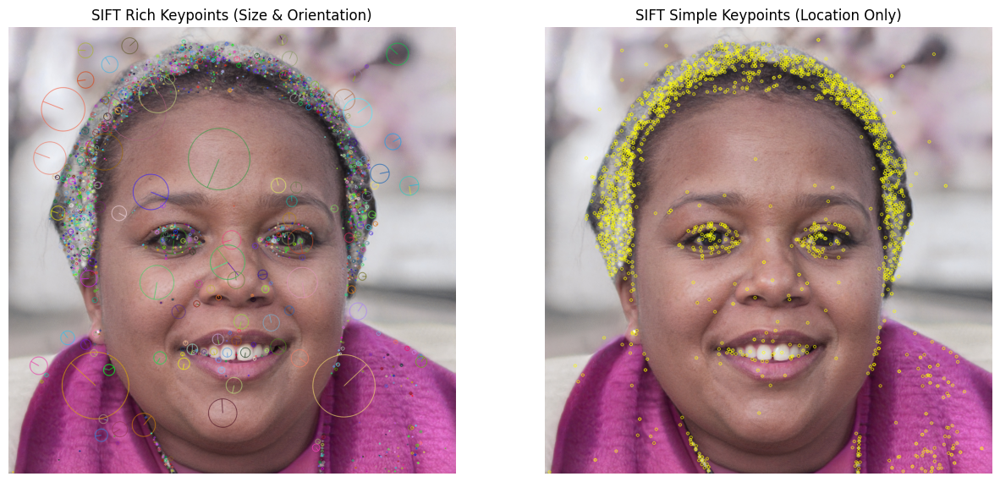

In [ ]:
# --- a. SIFT Initialization ---

# 1. Create the SIFT detector
sift = cv2.SIFT_create()

# 2. Detect keypoints and compute descriptors
# We use 'gray' because feature detection is usually done on single-channel images
keypoints, descriptors = sift.detectAndCompute(gray, None)

print(f"Number of keypoints detected: {len(keypoints)}")

# 3. Prepare copies of the image to draw on so we don't overwrite the original
# This replaces your 'keypoints_without_size = np.copy(img_rgb)' line for clarity
img_rich = img.copy()
img_simple = img.copy()

# 4. Draw the results
# Result 1: Rich Keypoints (Shows location, size, and orientation)
cv2.drawKeypoints(img, keypoints, img_rich,
                  flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

# Result 2: Simple Keypoints (Shows location only, in Green)
cv2.drawKeypoints(img, keypoints, img_simple,
                  color=(255, 255, 0),
                  flags=0)

# 5. Plot the results
f = plt.figure(figsize=(15, 8))

f.add_subplot(1, 2, 1)
plt.imshow(img_rich)
plt.title("SIFT Rich Keypoints (Size & Orientation)")
plt.axis("off")

f.add_subplot(1, 2, 2)
plt.imshow(img_simple)
plt.title("SIFT Simple Keypoints (Location Only)")
plt.axis("off")

plt.show()

In [ ]:
# Explain your understanding here

Summery of my understanding:

This algorithm "SIFT" stands for Scale-Invariant Feature Transform, help to detect and describe distinctive points locally in the images, making them robust to changes in scale, rotation, and lighting. As I see, most of the keypoints are located on the edges, so from my point of view, this algorithm do the edge detection behind the scene. In some other points, if I connect the points, they may draw the eyebrow, nose, mouse etc. These points have the (x, y) which can help to determine the location off each object in the image.

Another feature that this algorithm has is the descriptor, which is based on the gradient magnitudes and orientations in its local neighborhood, effectively creating a "signature of the region", that vector can help to recognize specific point in a different image later.





Keypoints WITH Non-max Suppression: 7051
Keypoints WITHOUT Non-max Suppression: 27512


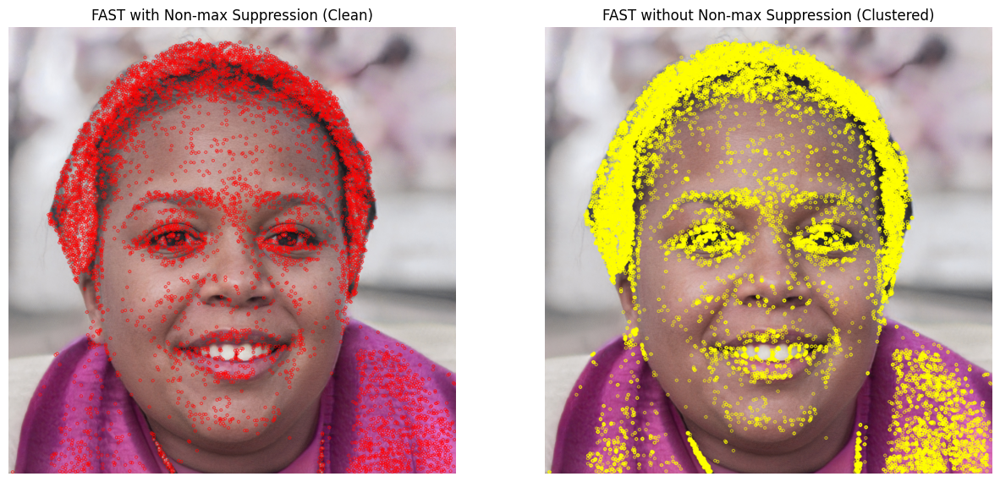

In [ ]:
# --- b. FAST Initialization ---

fast = cv2.FastFeatureDetector_create()

# ---------------------------------------------------------
# 1. Detect with Non-Max Suppression (Default: True)
# ---------------------------------------------------------
# Non-max suppression ensures we don't get a "clump" of points
# at one corner, but rather the single best point.
keypoints_with_nonmax = fast.detect(gray, None)

print(f"Keypoints WITH Non-max Suppression: {len(keypoints_with_nonmax)}")

# Prepare image to draw on
img_with_nonmax = img.copy()

# Draw result 1
cv2.drawKeypoints(img, keypoints_with_nonmax, img_with_nonmax,
                  color=(255, 0, 0)) # Drawing in Yellow


# ---------------------------------------------------------
# 2. Detect WITHOUT Non-Max Suppression
# ---------------------------------------------------------
# We turn off suppression to see all candidate points
fast.setNonmaxSuppression(False)

keypoints_without_nonmax = fast.detect(gray, None)

print(f"Keypoints WITHOUT Non-max Suppression: {len(keypoints_without_nonmax)}")

# Prepare image to draw on
img_without_nonmax = img.copy()

# Draw result 2
cv2.drawKeypoints(img, keypoints_without_nonmax, img_without_nonmax,
                  color=(255, 255, 0)) # Drawing in Red


# ---------------------------------------------------------
# 3. Plot the results
# ---------------------------------------------------------
f = plt.figure(figsize=(15, 8))

f.add_subplot(1, 2, 1)
plt.imshow(img_with_nonmax)
plt.title("FAST with Non-max Suppression (Clean)")
plt.axis("off")

f.add_subplot(1, 2, 2)
plt.imshow(img_without_nonmax)
plt.title("FAST without Non-max Suppression (Clustered)")
plt.axis("off")

plt.show()

In [ ]:
# Explain your understanding here:

Summery of my understanding:

FAST (Features from Accelerated Segment Test) detects corner points that remain meaningful even without the underlying image—for example, the points alone can still outline a human face. To understand the role of Non-Max Suppression (NMS), I compared FAST with and without it. Without NMS, the algorithm produces almost four times more keypoints because many redundant corners in the same area are kept. NMS removes these duplicates by keeping only the strongest corner in each neighborhood, resulting in a cleaner, more reliable set of features. This improves the quality of keypoints used in later tasks such as matching, tracking, and SLAM.


In [ ]:
# c- ORB
orb = cv2.ORB_create()
original_keypoints, original_descriptor = orb.detectAndCompute(#put something here- maybe use above approach)
query_keypoints, query_descriptor = orb.detectAndCompute(#put something here- maybe use above approach)
keypoints_without_size = np.copy(img_rgb)
keypoints_with_size = np.copy(img_rgb)

# Draw the result
# Use above approach to create result 1 and result 2 and draw them

1- Initialization: Creates the ORB detector object.

2- Detection: Computes the keypoints (coordinates) and descriptors (fingerprints) from the grayscale image.

3- Rich Visualization: Draws the keypoints with circles to show their size and orientation.

4- Simple Visualization: Draws the keypoints as green dots to show only their location.

5- Display: Plots the two resulting images side-by-side for comparison.

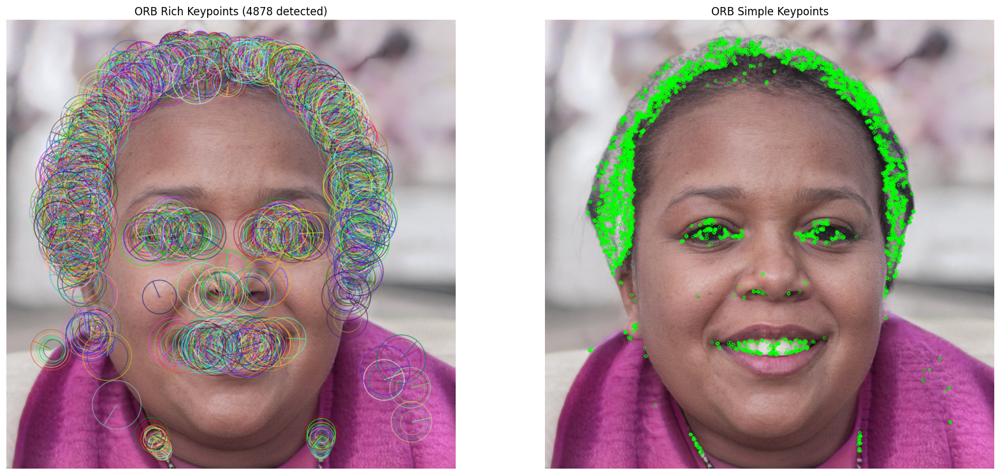

In [ ]:
# --- c. ORB Initialization ---
orb = cv2.ORB_create(nfeatures=5000)

# 1. Detect and Compute on the main image
# We use 'gray' (created in the very first step) for detection
original_keypoints, original_descriptor = orb.detectAndCompute(gray, None)

# (Skipped 'query_keypoints' step as per your request to focus only on 'img')

# 2. Prepare copies of the image to draw on
keypoints_without_size = np.copy(img)
keypoints_with_size = np.copy(img)

# 3. Draw the results
# Result 1: Rich Keypoints (Shows size and orientation circles)
cv2.drawKeypoints(img, original_keypoints, keypoints_with_size,
                  flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

# Result 2: Simple Keypoints (Shows location only, in Green)
cv2.drawKeypoints(img, original_keypoints, keypoints_without_size,
                  color=(0, 255, 0),
                  flags=0)

# 4. Plot the results side-by-side
f = plt.figure(figsize=(20, 10))

# Left: Rich Keypoints
f.add_subplot(1, 2, 1)
plt.imshow(keypoints_with_size)
plt.title(f"ORB Rich Keypoints ({len(original_keypoints)} detected)")
plt.axis("off")

# Right: Simple Keypoints
f.add_subplot(1, 2, 2)
plt.imshow(keypoints_without_size)
plt.title("ORB Simple Keypoints")
plt.axis("off")

plt.show()

In [ ]:
# Explain your understanding here:

Summery of my understanding:

**ORB** (Oriented **FAST** and Rotated **BRIEF**) is a real-time feature detector and descriptor widely used in computer vision tasks such as object tracking, image matching, and stitching. It efficiently identifies keypoints in an image and generates a compact binary descriptor for each one.

ORB is powerful because it is a hybrid method: it combines the speed of the FAST corner detector with the rotation-invariant BRIEF descriptor, making it both fast and robust to changes in orientation.

As a result, ORB produces reliable feature points that can be used effectively in later stages of a vision pipeline.

I personally impelement hybrid algorithms like ORB because they often deliver more stable and trustworthy results in real decision-making systems.

Here are the steps executed in the code:


1-Initialize ORB: Create the ORB feature detector.

2-Extract Original Features: Compute keypoints and descriptors for the RGB image.

3-Extract Query Features: Compute keypoints and descriptors for the Grayscale image.

4-Configure Matcher: Set up the Brute Force Matcher with Hamming distance and Cross-Check enabled.

5-Match Features: Compare descriptors to find identical points between the two images.

6-Sort Results: Order the matches by distance to prioritize the strongest connections.

7-Visualize Matches: Draw lines connecting the top 500 matching points between the images.

8-Display Image: Plot the visual result using Matplotlib.

9-Print Statistics: Output the total count of successful matches.

In [ ]:
# --- d. Finding the matching points (Original vs. Grayscale) ---

# 1. Initialize ORB
orb = cv2.ORB_create()

# 2. Compute Features for the "Original" (RGB)
# Even though it's RGB, the detector uses the grayscale version behind the scenes
original_keypoints, original_descriptor = orb.detectAndCompute(gray, None)

# 3. Compute Features for the "Query" (Grayscale)
# This is mathematically identical to the step above
query_keypoints, query_descriptor = orb.detectAndCompute(gray, None)

# 4. Brute Force Matching
# NORM_HAMMING is standard for ORB. crossCheck=True reduces errors.
brute_force = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

matches = brute_force.match(original_descriptor, query_descriptor)

# Sort matches by distance (best matches first)
matches = sorted(matches, key=lambda x: x.distance)

# 5. Draw the Result
# We map: img (Left) -> gray (Right)
result = cv2.drawMatches(img, original_keypoints,
                         gray, query_keypoints,
                         matches[:500],   # Draw only top 200 matches to keep it clean
                         None,
                         flags=2)

# 6. Plot
plt.figure(figsize=(20, 10))
plt.imshow(result)
plt.title(f"Matching Original vs Grayscale: {len(matches)} matches found")
plt.axis("off")
plt.show()

print("The number of matching keypoints between the original and the query image is {}\n".format(len(matches)))

In [ ]:
# Explain your understanding here. What is the goal of this matching point?

Summery of my understanding:

The primary goal of feature matching is to enable a computer to automatically recognize that a specific point in one image is the exact same physical object as a point in another image. By comparing the mathematical "fingerprints" (descriptors) of detected keypoints, the algorithm allows the system to look past differences in lighting, rotation, or scale to find corresponding pairs. This connects the "where" (the location of a corner) with the "what" (the texture around it), creating a reliable link between two separate visual data sources.

In the specific context of this code, matching the original image against its grayscale version serves as a validation step to prove the algorithm's robustness. By successfully linking the RGB features to the Grayscale features with perfect, straight lines, it demonstrates that the ORB algorithm creates consistent descriptors that do not rely on color data (a validation test). This fundamental capability is the building block for real-world applications, such as stitching multiple photos into a panorama, stabilizing shaky video footage, or tracking an object as it moves across a screen.

In the field of structural health monitoring, this approach can be extremely useful. If you have a set of reference images containing various types of weld defects—each labeled or segmented by defect category—the system can analyze any new incoming image, detect the mathematical similarities, and accurately identify the corresponding defect in the new photo.




**Part 2- Face recognition**

In [ ]:
!ls

apple.jpg	      haarcascade_frontalface_default.xml
Assignment4.pdf       MostafaZamaniturk_AAI-521-Assignment4.ipynb
Assignment4_pic1.jpg  weld1.jpg
Assignment4_pic2.jpg  weld2.jpg
haarcascade_eye.xml


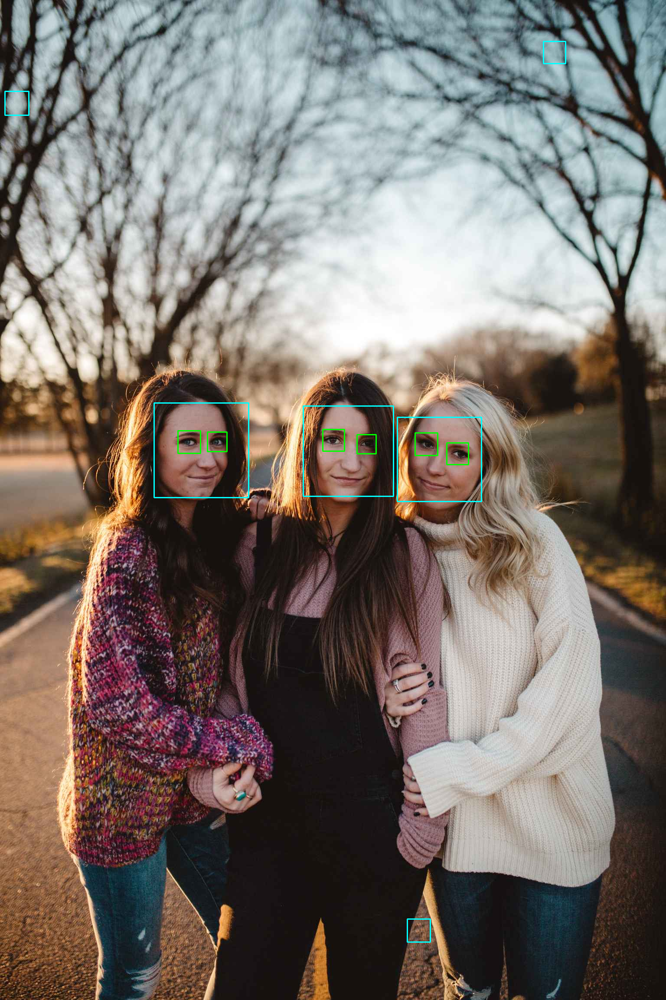

In [ ]:
# 1. Load Cascades
# (Ensure these paths are correct in your Google Drive)
face_cascade = cv2.CascadeClassifier("/content/drive/MyDrive/ColabNotebooks/AAI-521/Assignment4/haarcascade_frontalface_default.xml")
eye_cascade = cv2.CascadeClassifier("/content/drive/MyDrive/ColabNotebooks/AAI-521/Assignment4/haarcascade_eye.xml")

# 2. Read Image
img = cv2.imread("/content/drive/MyDrive/ColabNotebooks/AAI-521/Assignment4/Assignment4_pic2.jpg")

# 3. Convert BGR (OpenCV default) to RGB (for Matplotlib) and Gray (for Detection)
# It is important to convert to RGB for the final colored rectangles to look right
gray = gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

# 4. Detect Faces
faces = face_cascade.detectMultiScale(gray, 1.3, 5)

for (x,y,w,h) in faces:
    # Draw rectangle around face (Blue color in RGB: 0, 0, 255; Yellow: 255, 255, 0)
    # Note: Drawing on 'img_rgb' directly
    img1 = cv2.rectangle(img,(x, y),(x + w, y + h),(255,255,0),2)

    # Region of Interest (ROI) for eyes (limited to the face area)
    roi_gray = gray[y: y + h, x: x + w]
    roi_color = img[y: y + h, x: x + w]

    # Detect Eyes
    eyes = eye_cascade.detectMultiScale(roi_gray)

    for (ex, ey, ew, eh) in eyes:
        # Draw rectangle around eyes (Green)
        cv2.rectangle(roi_color,(ex, ey), (ex + ew, ey + eh), (0,255,0),2)

cv2_imshow(img)

Here, there are two false positives are detected as faces which are not faces, but when I take a look at them, something like faces are visible, which can demonstrate the high power of cascade to recognize faces!

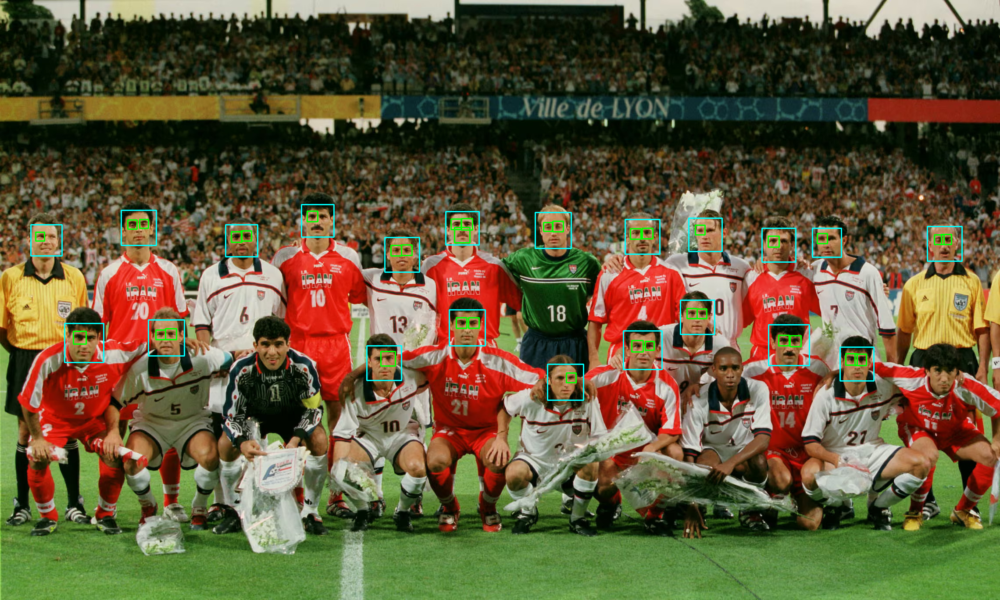

In [ ]:
# 1. Load Cascades
# (Ensure these paths are correct in your Google Drive)
face_cascade = cv2.CascadeClassifier("/content/drive/MyDrive/ColabNotebooks/AAI-521/Assignment4/haarcascade_frontalface_default.xml")
eye_cascade = cv2.CascadeClassifier("/content/drive/MyDrive/ColabNotebooks/AAI-521/Assignment4/haarcascade_eye.xml")

# 2. Read Image
img = cv2.imread("/content/drive/MyDrive/ColabNotebooks/AAI-521/Assignment4/Iran-1998.jpg")

# 3. Convert BGR (OpenCV default) to RGB (for Matplotlib) and Gray (for Detection)
# It is important to convert to RGB for the final colored rectangles to look right
gray = gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

# 4. Detect Faces
faces = face_cascade.detectMultiScale(gray, 1.3, 5)

for (x,y,w,h) in faces:
    # Draw rectangle around face (Blue color in RGB: 0, 0, 255; Yellow: 255, 255, 0)
    # Note: Drawing on 'img_rgb' directly
    img1 = cv2.rectangle(img,(x, y),(x + w, y + h),(255,255,0),2)

    # Region of Interest (ROI) for eyes (limited to the face area)
    roi_gray = gray[y: y + h, x: x + w]
    roi_color = img[y: y + h, x: x + w]

    # Detect Eyes
    eyes = eye_cascade.detectMultiScale(roi_gray)

    for (ex, ey, ew, eh) in eyes:
        # Draw rectangle around eyes (Green)
        cv2.rectangle(roi_color,(ex, ey), (ex + ew, ey + eh), (0,255,0),2)

cv2_imshow(img)

In this photo, as it can be seen, the algorithm could not detect all head and eyes. I am looking for the reasons. Some of undetected eyes have shadow which make them black and hard to detect, but some others

In [ ]:
#b- Working on webcam
#Function to activate your laptop cam. This function is complete and you don't need to do anything.
def take_photo(filename='photo.jpg', quality=0.8):
  js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Capture to be clicked.
      await new Promise((resolve) => capture.onclick = resolve);

      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }
    ''')
  display(js)
  data = eval_js('takePhoto({})'.format(quality))
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)
  return filename

<IPython.core.display.Javascript object>

Saved to photo.jpg


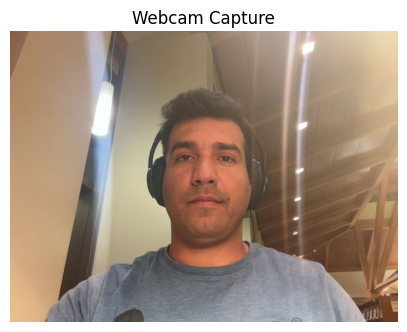

In [ ]:
try:
  # 1. Call the function to take the photo
  filename = take_photo()
  print('Saved to {}'.format(filename))

  # 2. Show the photo you just took using OpenCV and Matplotlib
  # (We reuse the display logic you learned earlier)
  img = cv2.imread(filename)

  # Convert to RGB for correct color display
  img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

  plt.figure(figsize=(5, 5))
  plt.imshow(img_rgb)
  plt.title("Webcam Capture")
  plt.axis('off')
  plt.show()

except Exception as err:
  # Errors will happen if no webcam is found or you deny permission
  print(str(err))

In [ ]:
!ls

apple.jpg	      haarcascade_eye.xml			   photo.jpg
Assignment4.pdf       haarcascade_frontalface_default.xml	   weld1.jpg
Assignment4_pic1.jpg  Iran-1998.jpg				   weld2.jpg
Assignment4_pic2.jpg  MostafaZamaniturk_AAI-521-Assignment4.ipynb


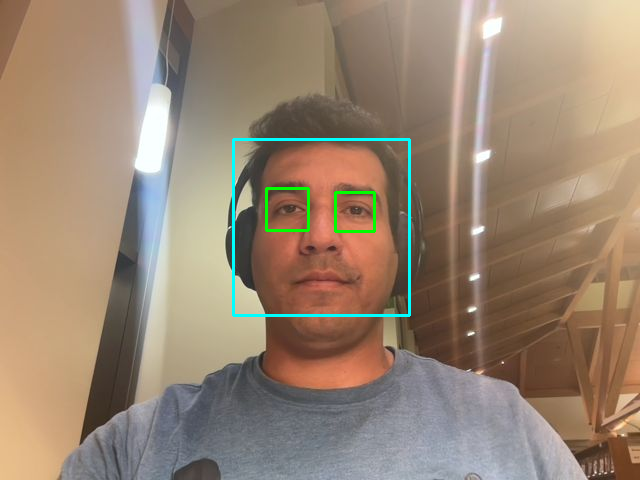

In [ ]:
# 1. Load Cascades
# (Ensure these paths are correct in your Google Drive)
face_cascade = cv2.CascadeClassifier("/content/drive/MyDrive/ColabNotebooks/AAI-521/Assignment4/haarcascade_frontalface_default.xml")
eye_cascade = cv2.CascadeClassifier("/content/drive/MyDrive/ColabNotebooks/AAI-521/Assignment4/haarcascade_eye.xml")

# 2. Read Image
img = cv2.imread("/content/drive/MyDrive/ColabNotebooks/AAI-521/Assignment4/photo.jpg")

# 3. Convert BGR (OpenCV default) to RGB (for Matplotlib) and Gray (for Detection)
# It is important to convert to RGB for the final colored rectangles to look right
gray = gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

# 4. Detect Faces
faces = face_cascade.detectMultiScale(gray, 1.3, 5)

for (x,y,w,h) in faces:
    # Draw rectangle around face (Blue color in RGB: 0, 0, 255; Yellow: 255, 255, 0)
    # Note: Drawing on 'img_rgb' directly
    img1 = cv2.rectangle(img,(x, y),(x + w, y + h),(255,255,0),2)

    # Region of Interest (ROI) for eyes (limited to the face area)
    roi_gray = gray[y: y + h, x: x + w]
    roi_color = img[y: y + h, x: x + w]

    # Detect Eyes
    eyes = eye_cascade.detectMultiScale(roi_gray)

    for (ex, ey, ew, eh) in eyes:
        # Draw rectangle around eyes (Green)
        cv2.rectangle(roi_color,(ex, ey), (ex + ew, ey + eh), (0,255,0),2)

cv2_imshow(img)

**Part 3- Parameter detection**

Original Image:


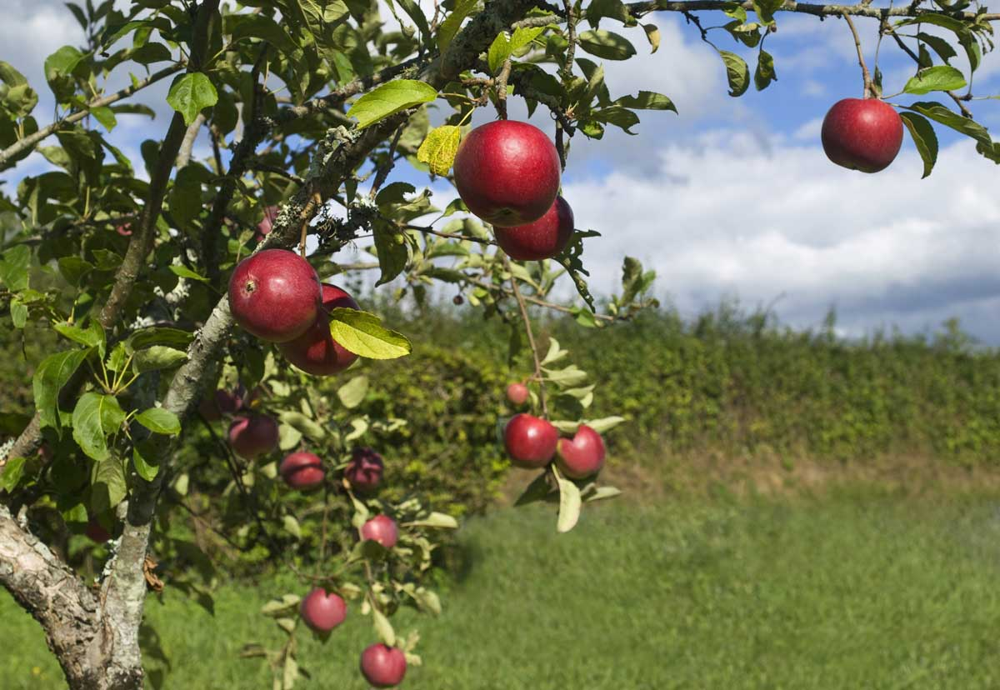

In [ ]:
# Reload the image from the file to get a clean copy
original_apple = cv2.imread('/content/drive/MyDrive/ColabNotebooks/AAI-521/Assignment4/apple.jpg')

# Display it
print("Original Image:")
cv2_imshow(original_apple)

HSV Image:


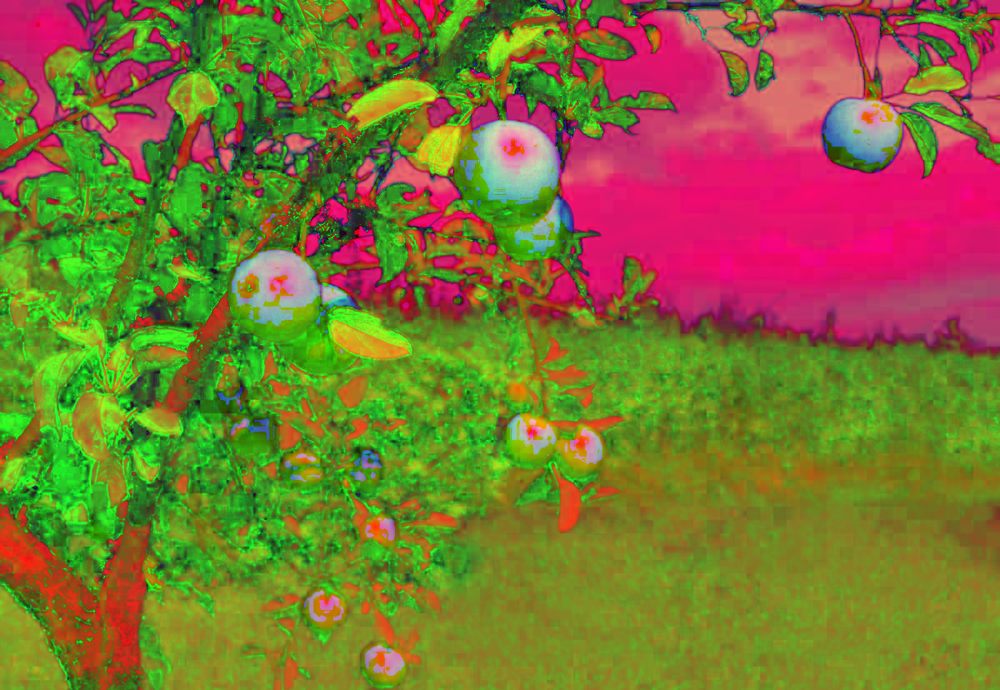


Mask (Raw):


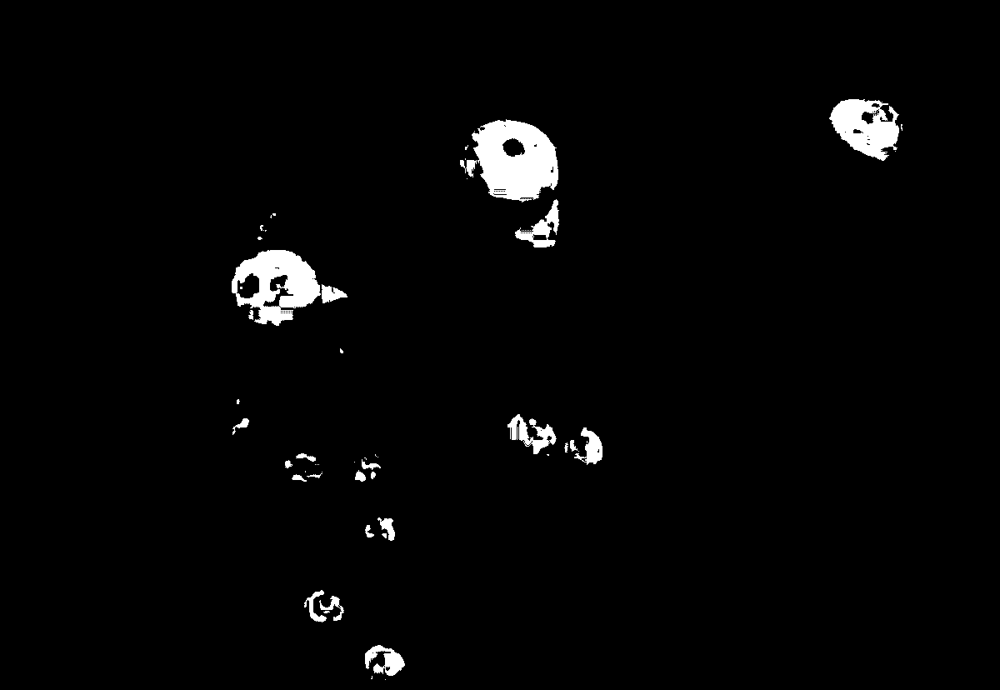


Mask Open (Noise Removed):


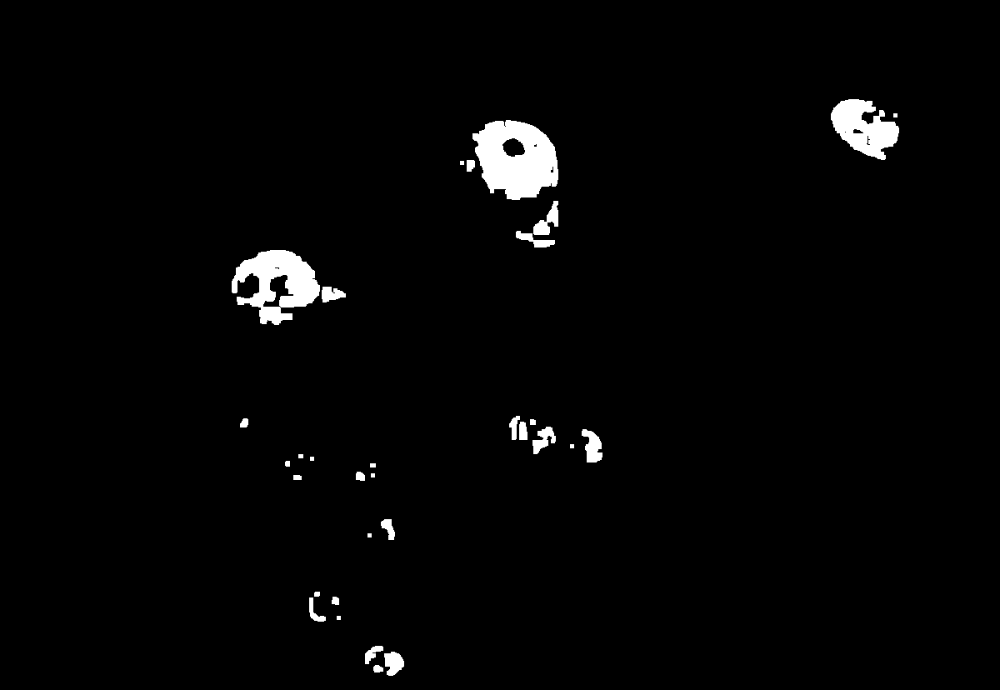


Mask Close (Holes Filled):


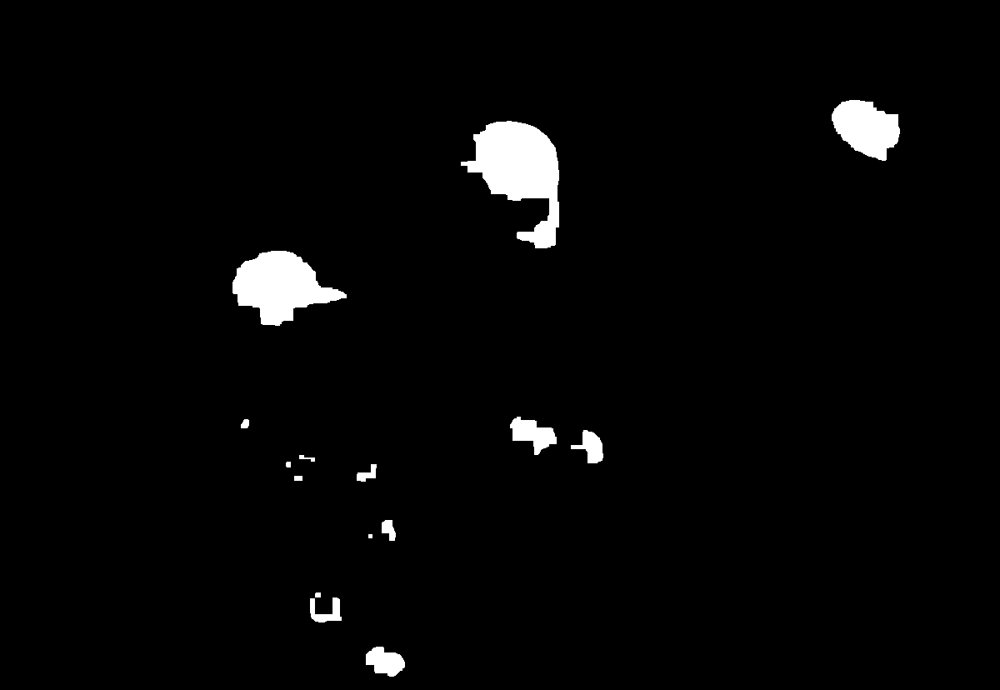


Final Result:


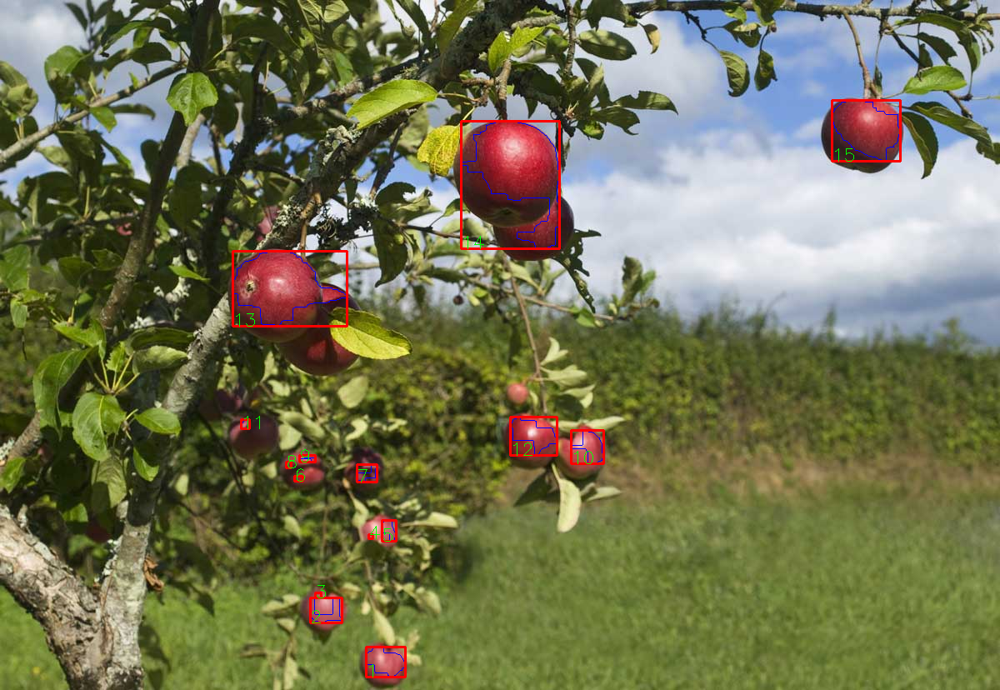

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# Define the color range for Red (in HSV)
# Hue 170-180 is the upper end of the red spectrum
lowerBound = np.array([170, 100, 80])
upperBound = np.array([180, 256, 256])

# Define kernels for morphological operations (cleaning the mask)
kernelOpen = np.ones((5, 5))
kernelClose = np.ones((20, 20))

img = cv2.imread('/content/drive/MyDrive/ColabNotebooks/AAI-521/Assignment4/apple.jpg') # Ensure you have uploaded 'apple.jpg'

# 1. Convert BGR to HSV
# HSV (Hue, Saturation, Value) is much better for color filtering than RGB
imgHSV = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

# 2. Show this HSV image
print("HSV Image:")
cv2_imshow(imgHSV)
# -------------------------------

# 3. Create the Mask
# This creates a black & white image: White = pixels in red range, Black = everything else
mask = cv2.inRange(imgHSV, lowerBound, upperBound)

# 4. Morphology (Cleaning up the mask)
# Opening: Erosion followed by Dilation (Removes white noise dots from background)
maskOpen = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernelOpen)
# Closing: Dilation followed by Erosion (Fills black holes inside the object)
maskClose = cv2.morphologyEx(maskOpen, cv2.MORPH_CLOSE, kernelClose)

maskFinal = maskClose

# 5. Find Contours
conts, h = cv2.findContours(maskFinal.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)

# 6. Draw Results
cv2.drawContours(img, conts, -1, (255, 0, 0), 1)

for i in range(len(conts)):
    x, y, w, h = cv2.boundingRect(conts[i])
    # Draw red bounding box
    cv2.rectangle(img, (x, y), (x + w, y + h), (0, 0, 255), 2)
    # Number the object
    cv2.putText(img, str(i + 1), (x, y + h), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 255, 0))

# 7. Display all stages
print("\nMask (Raw):")
cv2_imshow(mask)

print("\nMask Open (Noise Removed):")
cv2_imshow(maskOpen)

print("\nMask Close (Holes Filled):")
cv2_imshow(maskClose)

print("\nFinal Result:")
cv2_imshow(img)

In [ ]:
print('There were ', len(conts), ' apples in this picture')

There were  15  apples in this picture


In the original photo, I can see 20 apples, but this algorithm detected only 15, which is not entirely accurate. It counted one apple twice and missed several clearly visible ones. Detecting apples that are partially hidden behind others, not fully ripe, or in shadow proved particularly challenging. These factors highlight the limitations of the algorithm in handling occlusions, varying colors, and lighting conditions.

One possible solution is to adjust the lower and upper bound values, which could improve the detection accuracy.

HSV Image:


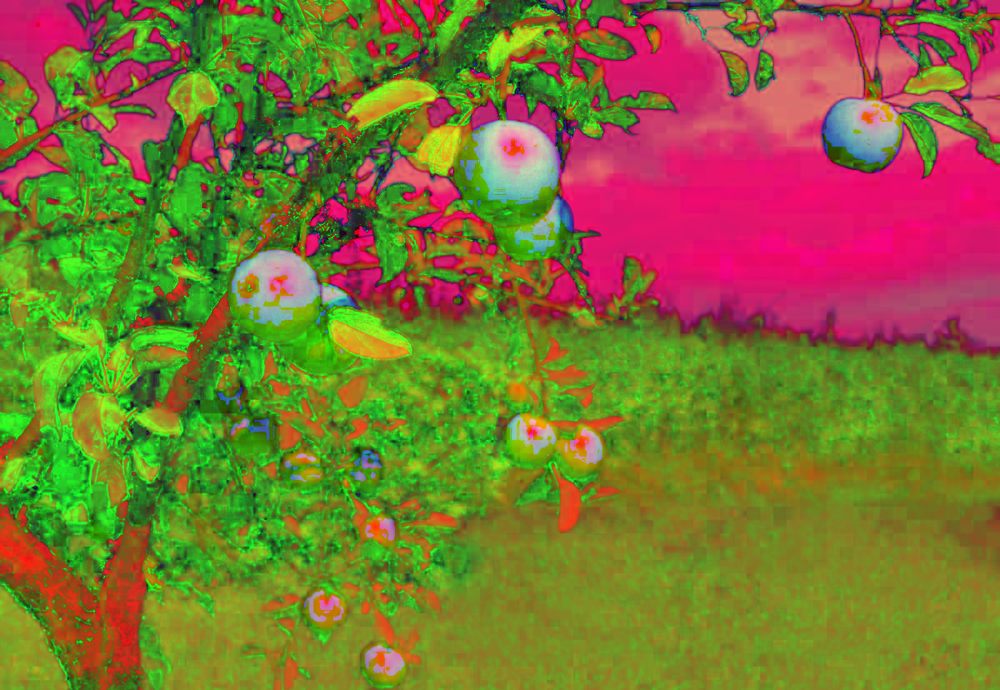


Mask (Raw):


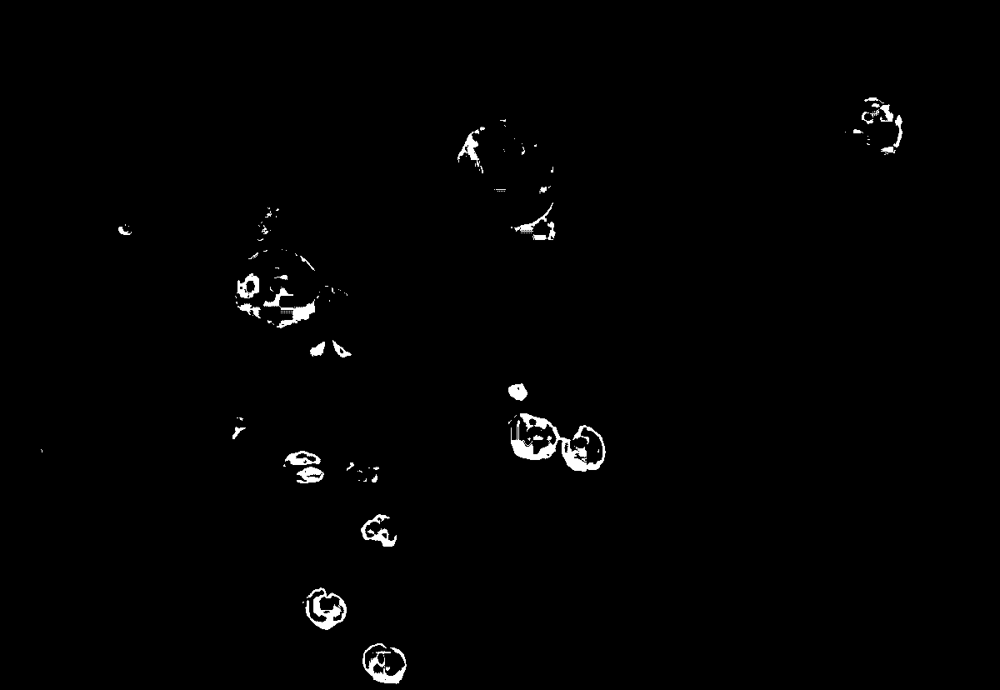


Mask Open (Noise Removed):


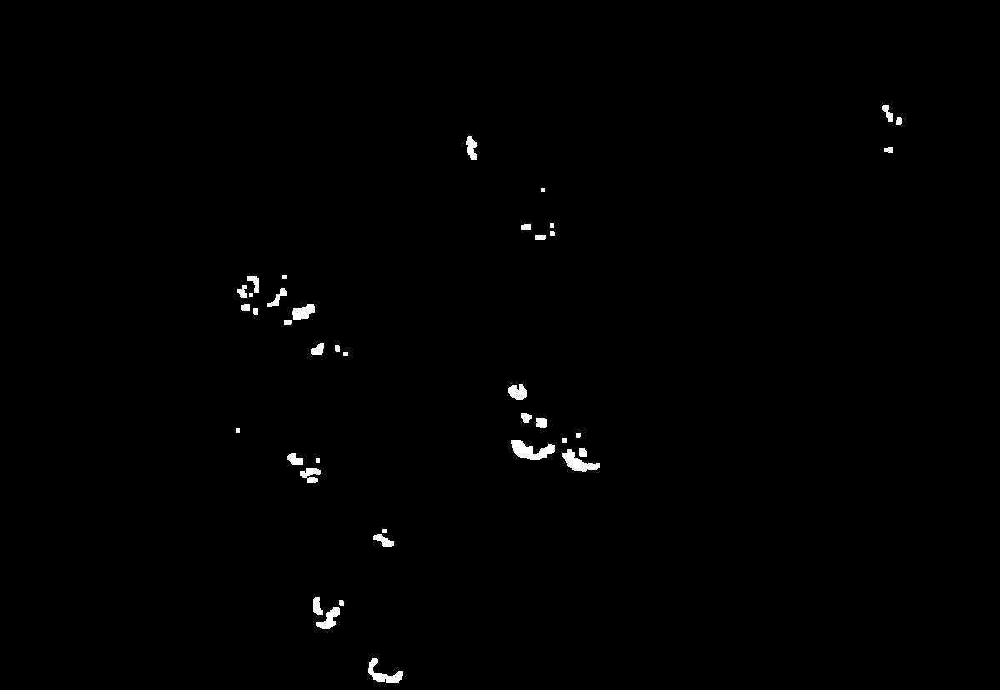


Mask Close (Holes Filled):


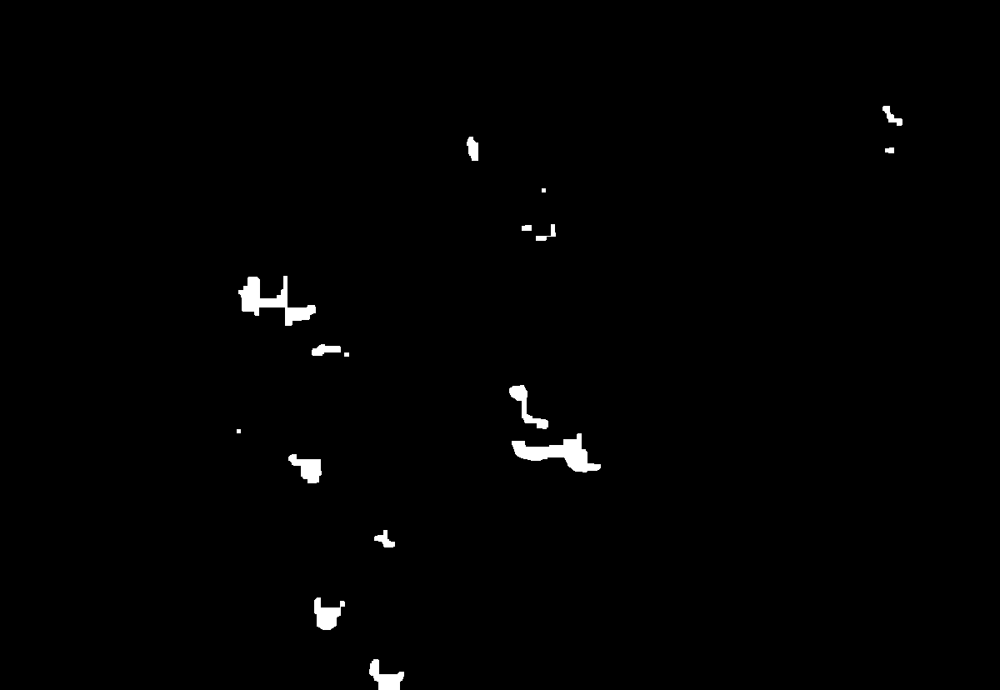


Final Result:


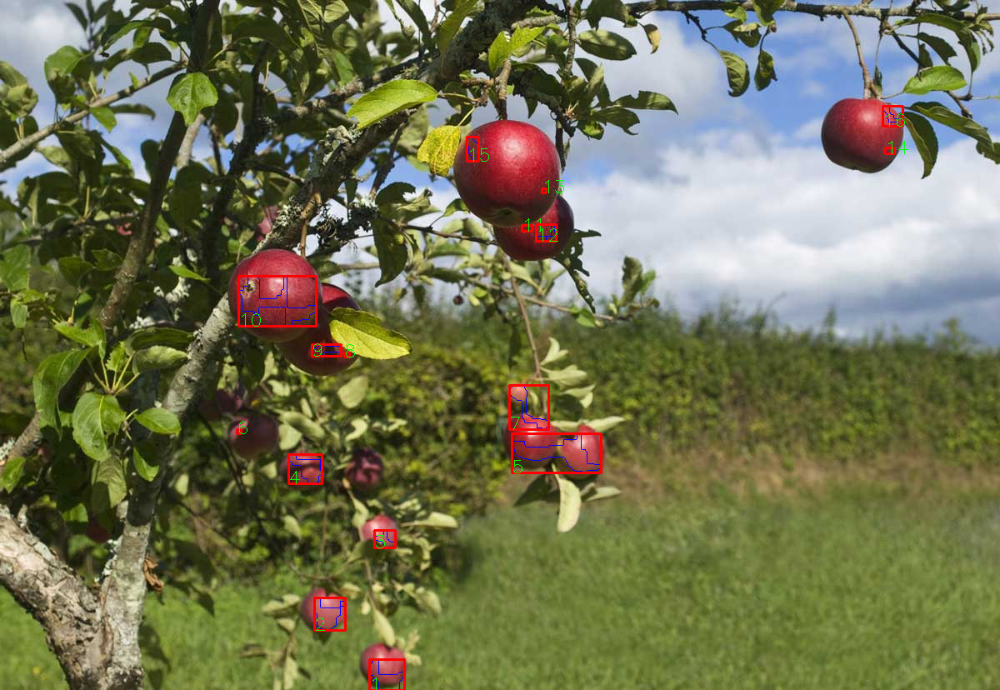

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# Define the color range for Red (in HSV)
# Hue 170-180 is the upper end of the red spectrum
lowerBound = np.array([0, 100, 100])
upperBound = np.array([10, 255, 255])

# Define kernels for morphological operations (cleaning the mask)
kernelOpen = np.ones((5, 5))
kernelClose = np.ones((20, 20))

img = cv2.imread('/content/drive/MyDrive/ColabNotebooks/AAI-521/Assignment4/apple.jpg') # Ensure you have uploaded 'apple.jpg'

# 1. Convert BGR to HSV
# HSV (Hue, Saturation, Value) is much better for color filtering than RGB
imgHSV = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

# 2. Show this HSV image
print("HSV Image:")
cv2_imshow(imgHSV)
# -------------------------------

# 3. Create the Mask
# This creates a black & white image: White = pixels in red range, Black = everything else
mask = cv2.inRange(imgHSV, lowerBound, upperBound)

# 4. Morphology (Cleaning up the mask)
# Opening: Erosion followed by Dilation (Removes white noise dots from background)
maskOpen = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernelOpen)
# Closing: Dilation followed by Erosion (Fills black holes inside the object)
maskClose = cv2.morphologyEx(maskOpen, cv2.MORPH_CLOSE, kernelClose)

maskFinal = maskClose

# 5. Find Contours
conts, h = cv2.findContours(maskFinal.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)

# 6. Draw Results
cv2.drawContours(img, conts, -1, (255, 0, 0), 1)

for i in range(len(conts)):
    x, y, w, h = cv2.boundingRect(conts[i])
    # Draw red bounding box
    cv2.rectangle(img, (x, y), (x + w, y + h), (0, 0, 255), 2)
    # Number the object
    cv2.putText(img, str(i + 1), (x, y + h), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 255, 0))

# 7. Display all stages
print("\nMask (Raw):")
cv2_imshow(mask)

print("\nMask Open (Noise Removed):")
cv2_imshow(maskOpen)

print("\nMask Close (Holes Filled):")
cv2_imshow(maskClose)

print("\nFinal Result:")
cv2_imshow(img)

In [ ]:
print('There were ', len(conts), ' apples in this picture')

There were  16  apples in this picture
